Current working directory: c:\dev_projects_pc\facade-analysis-ai\notebooks
Using device: cuda
GPU Name: NVIDIA GeForce RTX 3070 Ti
GPU Memory Allocated: 0.34 GB


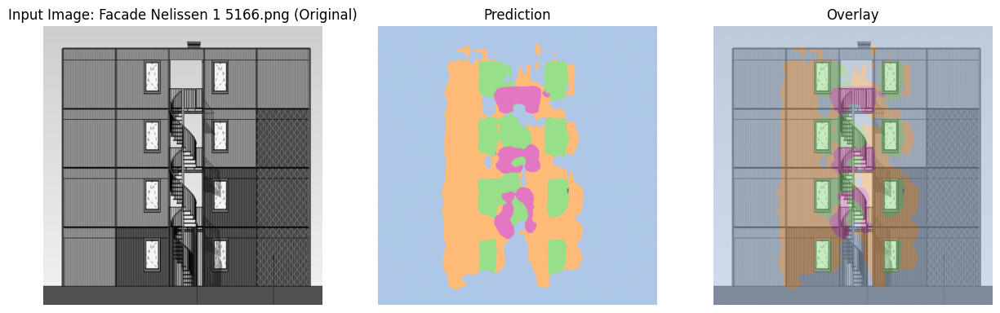

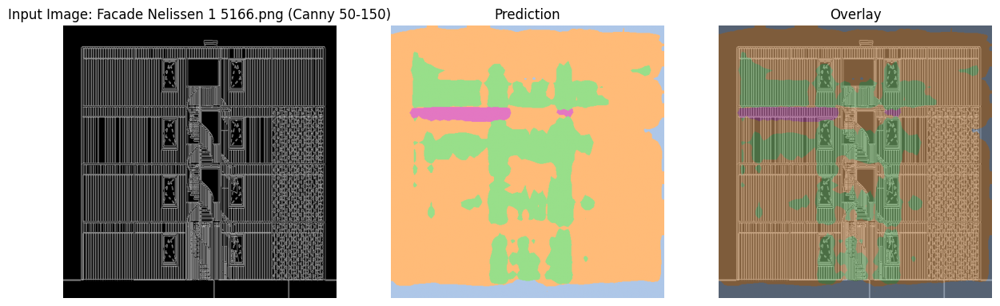

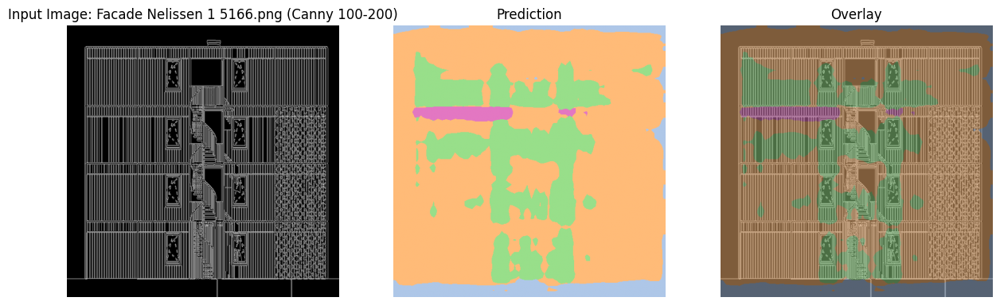

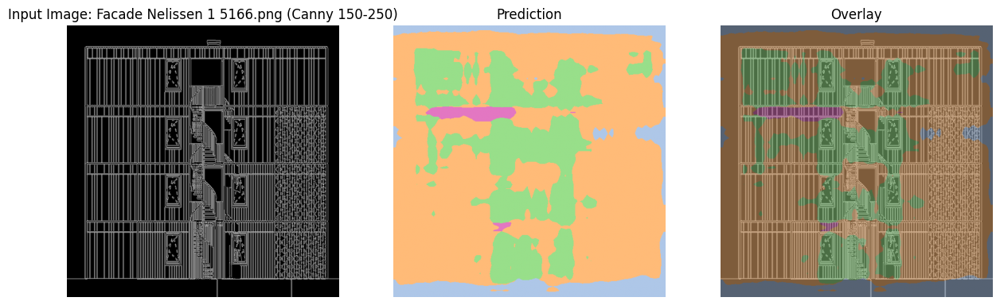

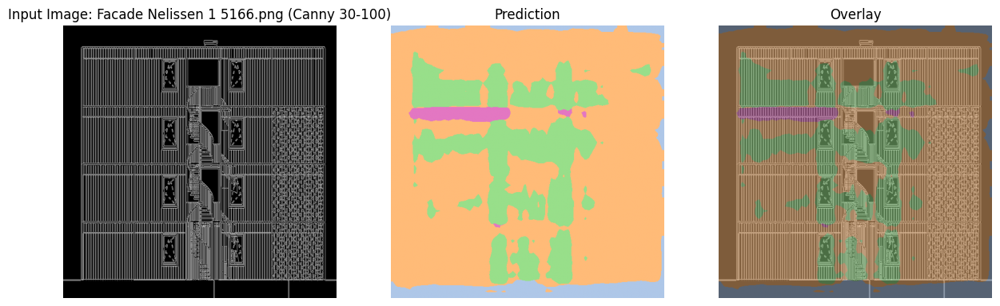

...

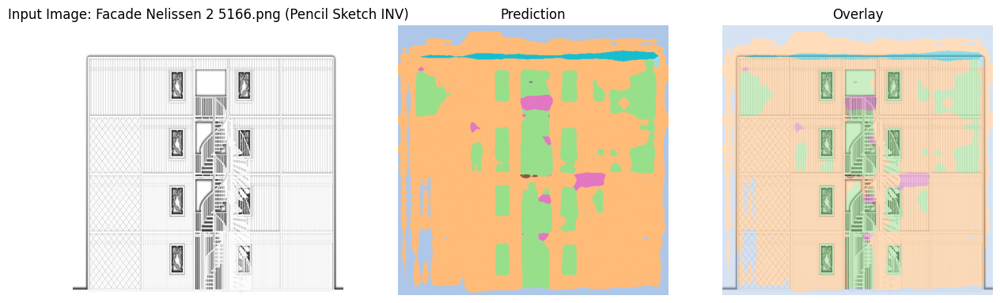

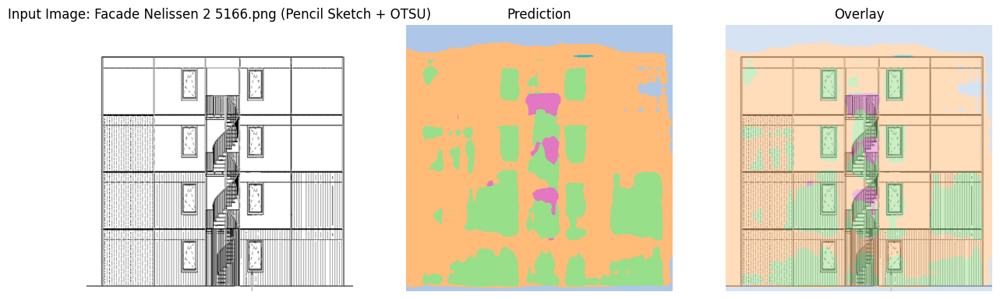

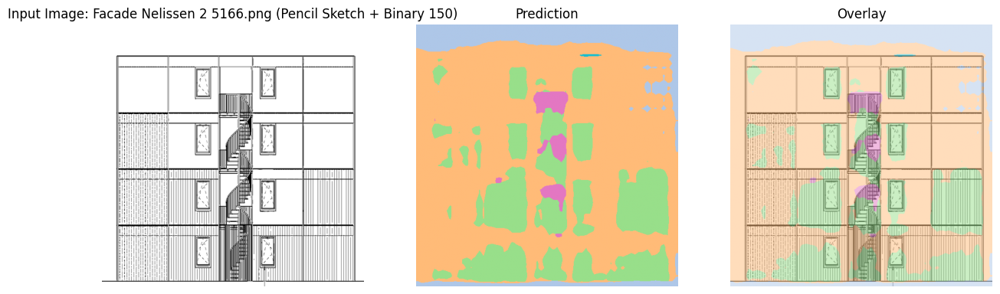

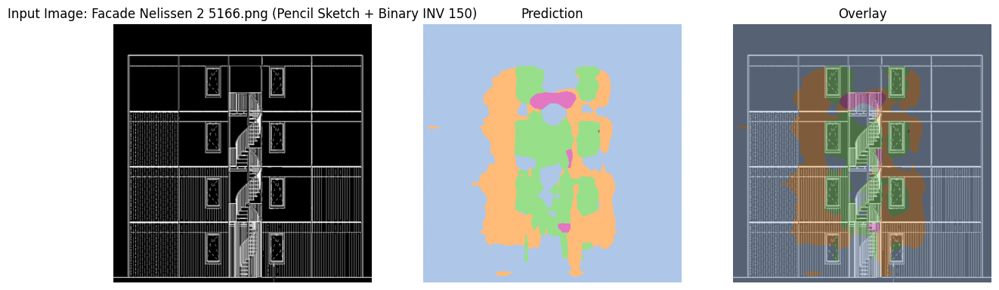

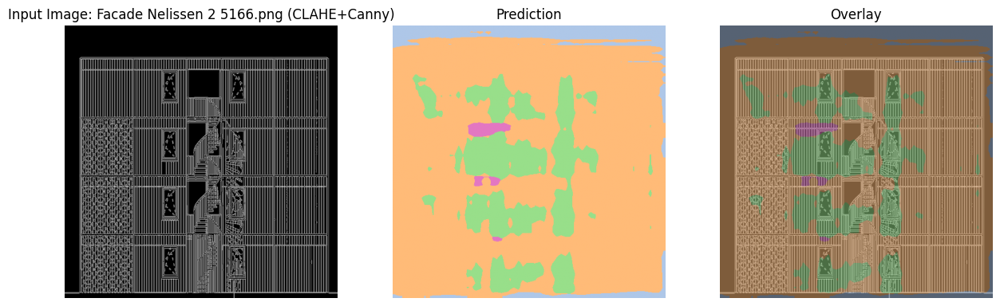

Script executed successfully


In [5]:
import os
import numpy as np
from PIL import Image
import torch
import torch.nn as nn
import torchvision
import matplotlib.pyplot as plt
import cv2

# Set up device (GPU if available)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Current working directory: {os.getcwd()}")
print(f"Using device: {device}")
if device.type == "cuda":
    print(f"GPU Name: {torch.cuda.get_device_name(0)}")
    print(f"GPU Memory Allocated: {torch.cuda.memory_allocated(0)/1024**3:.2f} GB")

# Load trained DeepLabv3 model with aux_loss=True
model = torchvision.models.segmentation.deeplabv3_resnet50(pretrained=False, aux_loss=True)
model.classifier[4] = nn.Conv2d(256, 12, kernel_size=(1, 1), stride=(1, 1))
model.load_state_dict(torch.load("deeplabv3_best_model.pth"))
model = model.to(device)
model.eval()

# Paths to sketch images
sketch_images = [
    "../data-samples/Nelissen Fotos/Facade Nelissen 1 5166.png",
    "../data-samples/Nelissen Fotos/Facade Nelissen 2 5148.png",
    "../data-samples/Nelissen Fotos/Facade Nelissen 2 5166.png"
]

# Extended edge/sketch processing methods
def edge_methods_sketch():
    return [
        ("Original", lambda img: img),
        ("Canny 50-150", lambda img: cv2.Canny(img, 50, 150)),
        ("Canny 100-200", lambda img: cv2.Canny(img, 100, 200)),
        ("Canny 150-250", lambda img: cv2.Canny(img, 150, 250)),
        ("Canny 30-100", lambda img: cv2.Canny(img, 30, 100)),
        ("Sobel k3", lambda img: cv2.convertScaleAbs(cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=3)) + cv2.convertScaleAbs(cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=3))),
        ("Sobel k5", lambda img: cv2.convertScaleAbs(cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=5)) + cv2.convertScaleAbs(cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=5))),
        ("Laplacian", lambda img: cv2.convertScaleAbs(cv2.Laplacian(img, cv2.CV_64F))),
        ("Adaptive Mean", lambda img: cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV, 11, 2)),
        ("Adaptive Gaussian", lambda img: cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 11, 2)),
        ("Adaptive Gaussian k15", lambda img: cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 15, 4)),
        ("OTSU", lambda img: cv2.threshold(img, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]),
        ("OTSU INV", lambda img: cv2.threshold(img, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]),
        ("OTSU + GaussianBlur", lambda img: cv2.threshold(cv2.GaussianBlur(img, (5,5), 0), 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]),
        ("Simple Binary 100", lambda img: cv2.threshold(img, 100, 255, cv2.THRESH_BINARY)[1]),
        ("Simple Binary 150", lambda img: cv2.threshold(img, 150, 255, cv2.THRESH_BINARY)[1]),
        ("Simple Binary 180", lambda img: cv2.threshold(img, 180, 255, cv2.THRESH_BINARY)[1]),
        ("Simple Binary INV 100", lambda img: cv2.threshold(img, 100, 255, cv2.THRESH_BINARY_INV)[1]),
        ("Simple Binary INV 150", lambda img: cv2.threshold(img, 150, 255, cv2.THRESH_BINARY_INV)[1]),
        ("Pencil Sketch", lambda img: cv2.divide(img, cv2.GaussianBlur(img, (21, 21), 0), scale=256.0)),
        ("Pencil Sketch INV", lambda img: cv2.divide(255-img, cv2.GaussianBlur(255-img, (21, 21), 0), scale=256.0)),
        ("Pencil Sketch + OTSU", lambda img: cv2.threshold(cv2.divide(img, cv2.GaussianBlur(img, (21, 21), 0), scale=256.0), 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]),
        ("Pencil Sketch + Binary 150", lambda img: cv2.threshold(cv2.divide(img, cv2.GaussianBlur(img, (21, 21), 0), scale=256.0), 150, 255, cv2.THRESH_BINARY)[1]),
        ("Pencil Sketch + Binary INV 150", lambda img: cv2.threshold(cv2.divide(img, cv2.GaussianBlur(img, (21, 21), 0), scale=256.0), 150, 255, cv2.THRESH_BINARY_INV)[1]),
        ("CLAHE+Canny", lambda img: cv2.Canny(cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8)).apply(img), 50, 150)),
    ]

# Process and predict for all sketch images and edge methods
resize_size = (512, 512)
methods = edge_methods_sketch()
max_images = 3  # Process all three images

for img_idx, image_path in enumerate(sketch_images):
    if img_idx >= max_images:
        break

    # Load image
    try:
        image = Image.open(image_path).convert("RGB")
    except Exception as e:
        print(f"Failed to load {image_path}: {e}")
        continue

    # Process each edge method
    for method_name, method_func in methods:
        # Preprocess image
        img_np = np.array(image.convert("RGB"))
        gray = cv2.cvtColor(img_np, cv2.COLOR_RGB2GRAY)
        
        try:
            # Apply edge method
            processed = method_func(gray)
            
            # Ensure 8-bit image
            if processed.dtype != np.uint8:
                processed = cv2.convertScaleAbs(processed)
            
            # Convert to 3-channel RGB
            if len(processed.shape) == 2:
                processed_rgb = cv2.cvtColor(processed, cv2.COLOR_GRAY2RGB)
            else:
                processed_rgb = processed
            
            # Convert back to PIL for resizing
            processed_pil = Image.fromarray(processed_rgb)
            processed_pil = processed_pil.resize(resize_size, Image.Resampling.LANCZOS)
            image_np = np.array(processed_pil)  # Keep for visualization
            image_tensor = torch.from_numpy(image_np).permute(2, 0, 1).float() / 255.0
            image_tensor = image_tensor.unsqueeze(0).to(device)

            # Perform inference
            with torch.no_grad():
                output = model(image_tensor)['out']
                prediction = torch.argmax(output, dim=1).squeeze(0).cpu().numpy()

            # Visualize the input image, prediction, and overlay
            plt.figure(figsize=(15, 5))

            # Input Image
            plt.subplot(1, 3, 1)
            plt.imshow(image_np)
            plt.title(f"Input Image: {os.path.basename(image_path)} ({method_name})")
            plt.axis("off")

            # Prediction
            plt.subplot(1, 3, 2)
            plt.imshow(prediction, cmap="tab20", vmin=0, vmax=11)
            plt.title("Prediction")
            plt.axis("off")

            # Overlay
            plt.subplot(1, 3, 3)
            plt.imshow(image_np)
            plt.imshow(prediction, cmap="tab20", vmin=0, vmax=11, alpha=0.5)
            plt.title("Overlay")
            plt.axis("off")

            plt.show()

        except Exception as e:
            print(f"Error processing {method_name} for {image_path}: {e}")

if __name__ == "__main__":
    print("Script executed successfully")
